# loading libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import os 
import glob
import pathlib
import pandas as pd
import numpy as np
import darts
from darts.models.forecasting.arima import ARIMA
from darts import TimeSeries
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller
import os
import glob
from tqdm import tqdm
from darts.dataprocessing.transformers.scaler import Scaler



The `LightGBM` module could not be imported. To enable LightGBM support in Darts, follow the detailed instructions in the installation guide: https://github.com/unit8co/darts/blob/master/INSTALL.md
/home/iffi/anaconda3/envs/darts/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
The `CatBoost` module could not be imported. To enable CatBoost support in Darts, follow the detailed instructions in the installation guide: https://github.com/unit8co/darts/blob/master/INSTALL.md


# Helping Functions


In [2]:
import numpy as np

def calculate_metrics(actual, predicted):
    # Convert inputs to numpy arrays for easier calculations
    actual = np.array(actual)
    predicted = np.array(predicted)
    
    # Calculate individual metrics
    mae = np.mean(np.abs(predicted - actual))
    rmse = np.sqrt(np.mean((predicted - actual) ** 2))
    mape = np.mean(np.abs((predicted - actual) / actual)) * 100
    mse = np.mean((predicted - actual) ** 2)
    
    metrics = {
        'MAE': mae,
        'RMSE': rmse,
        'MAPE': mape,
        'MSE': mse
    }
    
    return metrics


# Selected Time Store_Number % family
## Records
* Store Number : 1 & Family : Automative 
* Store Number : 2 & Family :Automative
* Store Number : 3 & Family :Automative
* Store Number : 7 & Family :Automative
* Store Number : 1 & Family : Seafood

In [3]:
fileName = '2_AUTOMOTIVE'
df = pd.read_csv(f'../ProcessedData/GroupData/{fileName}.csv')
df.head()


,date,id,store_nbr,family,sales,onpromotion,transactions,holiday_type,locale,locale_name,...,dcoilwtico,city,state,store_type,cluster,year,month,day_of_month,day_of_week,day_name
0,2013-01-02,1782,1,AUTOMOTIVE,2.0,0,2111,NaN,NaN,NaN,...,93.14,Quito,Pichincha,D,13,2013,1,2,2,Wednesday
1,2013-01-03,3564,1,AUTOMOTIVE,3.0,0,1833,NaN,NaN,NaN,...,92.97,Quito,Pichincha,D,13,2013,1,3,3,Thursday
2,2013-01-04,5346,1,AUTOMOTIVE,3.0,0,1863,NaN,NaN,NaN,...,93.12,Quito,Pichincha,D,13,2013,1,4,4,Friday
3,2013-01-05,7128,1,AUTOMOTIVE,5.0,0,1509,Work Day,National,Ecuador,...,NaN,Quito,Pichincha,D,13,2013,1,5,5,Saturday
4,2013-01-06,8910,1,AUTOMOTIVE,2.0,0,520,NaN,NaN,NaN,...,NaN,Quito,Pichincha,D,13,2013,1,6,6,Sunday


In [4]:
df = df[['date','sales']]
df = df.drop_duplicates()
df.head()

,date,sales
0,2013-01-02,2.0
1,2013-01-03,3.0
2,2013-01-04,3.0
3,2013-01-05,5.0
4,2013-01-06,2.0


# stationary Tesst

In [5]:
def adfuller_test(values):
    result=adfuller(values)
    labels = ['ADF Test Statistic','p-value','#Lags Used','Number of Observations Used']
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print("P value is less than 0.05 that means we can reject the null hypothesis(Ho). Therefore we can conclude that data has no unit root and is stationary")
    else:
        print("Weak evidence against null hypothesis that means time series has a unit root which indicates that it is non-stationary ")


In [6]:
adfuller_test(df['sales'])

ADF Test Statistic : -4.567364507345927
p-value : 0.0001482934256128482
#Lags Used : 13
Number of Observations Used : 573
P value is less than 0.05 that means we can reject the null hypothesis(Ho). Therefore we can conclude that data has no unit root and is stationary


## Spliting Data into Training & Testing Data

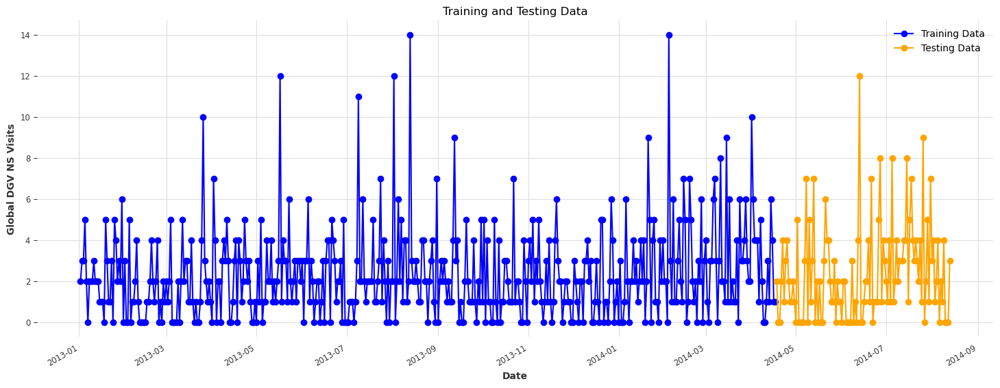

In [7]:
from darts import TimeSeries
import numpy as np
import matplotlib.pyplot as plt

# Assuming df is your DataFrame containing daily data
series = TimeSeries.from_dataframe(df, "date", "sales", freq='1D', fill_missing_dates=True, fillna_value=0)


split_point = 0.80

train_series, test_series = series.split_after(split_point)

# Set the figure size and style
plt.figure(figsize=(18, 6))
# Plot the training and testing data
train_series.plot(label='Training Data', color='blue', linewidth=1.5, marker='o')
test_series.plot(label='Testing Data', color='orange', linewidth=1.5, marker='o')

# Add title and labels
plt.title('Training and Testing Data')
plt.xlabel('Date')
plt.ylabel('Global DGV NS Visits')

# Add grid lines
plt.grid(True)

# Add legend
plt.legend()

# Display the plot
plt.show()


## Inspect Seasonality

In [ ]:
from darts.utils.statistics import plot_acf, check_seasonality

for m in range(2, 25):
    is_seasonal, period = check_seasonality(train_series, m=m, alpha=0.05)
    if is_seasonal:
        print("There is seasonality of order {}.".format(period))

## Auto Correlation plot
The autocorrelation function (ACF) is used to identify the order of ARIMA models. The ACF plot shows the correlation between the time series and its lagged version. The lag at which the ACF plot crosses the upper confidence interval for the first time is considered as the order of the **MA** component of the ARIMA model. Similarly, if the ACF plot decays slowly, it indicates that there is a high degree of autocorrelation in the time series, which means that an AR component should be included in the ARIMA model.

In [ ]:
from darts.utils.statistics import plot_acf,plot_pacf


plot_acf(train_series, m=7, max_lag=100,  fig_size=(10, 5), axis=None, default_formatting=True)
plt.xlabel('lags')
plt.ylabel('correlation')
plt.title('Auto Correlation Plot')
plt.show()

## Partial Auto Correlation plot
The partial autocorrelation function (PACF) is also used to identify the order of ARIMA models. The PACF plot shows the correlation between the time series and its lagged version, but with the influence of the intermediate lags removed. The lag at which the PACF plot crosses the upper confidence interval for the first time is considered as the order of the **AR** component of the ARIMA model.

In [ ]:
from darts.utils.statistics import plot_acf,plot_pacf
plot_pacf(train_series, m=7, max_lag=100,  fig_size=(10, 5), axis=None, default_formatting=True)

plt.xlabel('lags')
plt.ylabel('correlation')
plt.title('Partial Auto Correlation Plot')
plt.show()

# Model Fitting

## ARIMA Model Fitting

In [ ]:
from darts.dataprocessing.transformers.scaler import Scaler

arima_model = ARIMA(
    p=7,
    d=1, 
    q=7, 
    trend=None, 
    random_state=1999,
    add_encoders={
                'cyclic': {'future': ['month']},
                'datetime_attribute': {'future': ['hour', 'dayofweek']},
                'position': {'future': ['relative']},
                'custom': {'future': [lambda idx: (idx.year - 1950) / 50]},
                'transformer': Scaler()
            }
                                            ,
)

arima_model.fit(train_series)
arima_model.model.summary()

## SARIMA Model

In [ ]:

sarima_model = ARIMA(
    p=7,
    d=0, 
    q=7, 
    trend=None, 
    random_state=1999,
    seasonal_order=(2,1,2,14),
    add_encoders={
                'cyclic': {'future': ['month']},
                'datetime_attribute': {'future': ['hour', 'dayofweek']},
                'position': {'future': ['relative']},
                'custom': {'future': [lambda idx: (idx.year - 1950) / 50]},
                'transformer': Scaler()
            }
                                            ,
)

sarima_model.fit(train_series)
sarima_model.model.summary()

## Exponential Smoothing Model

In [ ]:
from darts.models.forecasting.exponential_smoothing import ExponentialSmoothing
from darts.utils.utils import ModelMode
from darts.utils.utils import SeasonalityMode
expo_smoot = ExponentialSmoothing(
                                trend=ModelMode.ADDITIVE,  
                                damped=True,
                                seasonal=SeasonalityMode.ADDITIVE,
                                seasonal_periods=4,
                                random_state=1999,
                                remove_bias=True,
                                smoothing_seasonal=0.3)

expo_smoot.fit(train_series)

# Print the summary of the trained model
print(expo_smoot.model.summary())


### GridSearch for Exponential Smoothing

In [ ]:
# from darts.models.forecasting.exponential_smoothing import ExponentialSmoothing
# from darts.utils.utils import ModelMode, SeasonalityMode
# from darts.metrics import mae
# import numpy as np

# # Define a range of hyperparameters for the grid search
# trend_modes = [ModelMode.ADDITIVE, ]
# damped_values = [True, False]
# seasonality_modes = [SeasonalityMode.ADDITIVE]
# seasonal_periods_values = [4,7,10, 14,17,21, 30]  # You can add more values
# smoothing_seasonal_values = [0.1, 0.3, 0.5]  # You can add more values
# remove_biass =  [True,False]
# smoothing_trends = [ 0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
# smoothing_levels = [ 0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
# best_mae = np.inf
# best_params = None

# # Perform grid search
# for trend_mode in trend_modes:
#     for damped in damped_values:
#         for seasonality_mode in seasonality_modes:
#             for seasonal_periods in seasonal_periods_values:
#                 for smoothing_seasonal in smoothing_seasonal_values:
#                     for remove_bias in remove_biass:
#                         for smoothing_trend in smoothing_trends:
#                             for smoothing_level in smoothing_levels:
                                
#                                 expo_smoot = ExponentialSmoothing(
#                                     trend=trend_mode,
#                                     damped=damped,
#                                     seasonal=seasonality_mode,
#                                     seasonal_periods=seasonal_periods,
#                                     random_state=1999,
#                                     remove_bias=remove_bias,
#                                     smoothing_seasonal=smoothing_seasonal,
#                                     smoothing_trend = smoothing_trend,
#                                     smoothing_level = smoothing_level
#                                 )
                                
#                                 expo_smoot.fit(train_series)
#                                 forecast = expo_smoot.predict(len(test_series))
#                                 mae_score = mae(test_series, forecast)
                                
#                                 if mae_score < best_mae:
#                                     best_mae = mae_score
#                                     best_params = {
#                                         'trend': trend_mode,
#                                         'damped': damped,
#                                         'seasonality': seasonality_mode,
#                                         'seasonal_periods': seasonal_periods,
#                                         'smoothing_seasonal': smoothing_seasonal
#                                     }

# print("Best parameters:", best_params)
# print("Best MAE:", best_mae)


## FacebookProphet

In [ ]:
prophet = Prophet(
    suppress_stdout_stderror=True,
    add_encoders={
        'cyclic': {'future': ['month']},
        'datetime_attribute': {'future': ['hour', 'dayofweek']},
        'position': {'future': ['relative']},
        'custom': {'future': [lambda idx: (idx.year - 1950) / 50]},
        'transformer': Scaler()
    },
    cap=None,
    floor=None,
    add_seasonalities=dict(
        name='custom_daily',
        seasonal_periods=24,
        fourier_order=6,
        prior_scale=10.0,
        mode='multiplicative'),
    country_holidays='US',
)
prophet.fit(train_series)

horizan = 30*6
# summary = arima_model.model.summary()

test_series_ = test_series[0:horizan]
plt.figure(figsize=(18, 6))
forcast_arima = prophet.predict(horizan)
prophet.predict(horizan).plot(marker='o',label='predicted')
test_series_.plot(marker='o',label='Actual/Ground truth')
# Add title and labels
plt.title('Ground truth vs predicted')
plt.xlabel('Date')
plt.ylabel('Global DGV NS Visits')
plt.xticks(forcast_arima.time_index, forcast_arima.time_index.strftime('%Y-%m-%d'), rotation=90)

# Add grid lines
plt.grid(True)

# Add legend
plt.legend()

# Display the plot
plt.show()


# XGB Model

Specified future encoders in `add_encoders` at model creation but model does not accept future covariates. future encoders will be ignored.


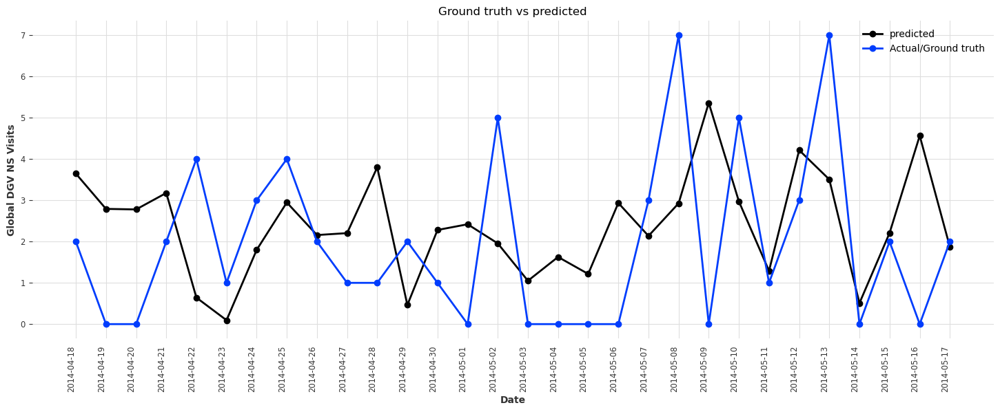

In [73]:
from darts.models.forecasting.xgboost import  XGBModel
xgb_model= XGBModel(lags=15, 
                    output_chunk_length=30, 
                     add_encoders={
                        'cyclic': {'future': ['month']},
                        'datetime_attribute': {'future': ['hour', 'dayofweek']},
                        'position': {'future': ['relative']},
                        'custom': {'future': [lambda idx: (idx.year - 2013) / 50]},
                        'transformer': Scaler()
                    }, 
                    likelihood=None, 
                    quantiles=True, 
                    random_state=199, 
                    multi_models=True, 
                    use_static_covariates=True)

xgb_model.fit(train_series)

horizan = 30

test_series_ = test_series[0:horizan]
plt.figure(figsize=(18, 6))
forcast_arima = xgb_model.predict(horizan)
xgb_model.predict(horizan).plot(marker='o',label='predicted')
test_series_.plot(marker='o',label='Actual/Ground truth')
# Add title and labels
plt.title('Ground truth vs predicted')
plt.xlabel('Date')
plt.ylabel('Global DGV NS Visits')
plt.xticks(forcast_arima.time_index, forcast_arima.time_index.strftime('%Y-%m-%d'), rotation=90)

# Add grid lines
plt.grid(True)

# Add legend
plt.legend()

# Display the plot
plt.show()


In [ ]:

import os
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm

# Function to predict and evaluate
def predict_and_evaluate(window_size, prediction_horizon, slide_step, test_series, arima_model,result_plot_path ):
    num_predictions = len(test_series) - window_size - prediction_horizon + 1
    
    meta_information_evaluation = {
        'Iterations': [],
        'MAE': [],
        'RMSE': [],
        'MAPE': [],
        'MSE': [],
        'input_window_size': [],
        'horizon': [],
        'stride': []
    }
    
    try:
        for i in tqdm(range(0, num_predictions, slide_step)):
            input_window = test_series[i:i + window_size]
            ground_truth = test_series[i + window_size:i + window_size + prediction_horizon]
            forecast = arima_model.predict(n=prediction_horizon, series=input_window)
            actual = ground_truth.values().flatten().tolist()
            predicted = forecast.values().flatten().tolist()
            metrics = calculate_metrics(actual, predicted)
            
            meta_information_evaluation['Iterations'].append(i)
            meta_information_evaluation['MAE'].append(metrics['MAE'])
            meta_information_evaluation['RMSE'].append(metrics['RMSE'])
            meta_information_evaluation['MAPE'].append(metrics['MAPE'])
            meta_information_evaluation['MSE'].append(metrics['MSE'])
            meta_information_evaluation['input_window_size'].append(window_size)
            meta_information_evaluation['horizon'].append(prediction_horizon)
            meta_information_evaluation['stride'].append(slide_step)
            
            bypass_information = {
                'slide_step':slide_step,
                'window_size':window_size,
                'horizon':prediction_horizon,            
            }
            create_plots(input_window,forecast,ground_truth,result_plot_path,bypass_information)

        evalaution_df = pd.DataFrame.from_dict(meta_information_evaluation)
        
        return evalaution_df
    
    except Exception as e:
        print('Error Occurred in fuction predict_and_evaluate():', e)
        evalaution_df = pd.DataFrame.from_dict(meta_information_evaluation)
        
        return evalaution_df

# Function to create plots
def create_plots(input_window, forecast, ground_truth,result_plot_path,bypass_information):
    plt.figure(figsize=(30, 6))
    input_window.plot(label='Input Data', marker='o')
    forecast.plot(label='Predicted', marker='o')
    ground_truth.plot(label='Ground Truth', marker='o')
    
    combined_time_index = input_window.time_index.append(forecast.time_index).append(ground_truth.time_index)
    starting_date_of_input_data = input_window.time_index[0].strftime("%Y-%m-%d")
    ending_date_of_input_data = input_window.time_index[-1].strftime("%Y-%m-%d")
    starting_date_predicted = forecast.time_index[0].strftime("%Y-%m-%d")
    ending_date_of_predicted = forecast.time_index[-1].strftime("%Y-%m-%d")
    
    plt.xticks(combined_time_index, combined_time_index.strftime('%Y-%m-%d'), rotation=90)
    plt.title(f'Results of Input Data from {starting_date_of_input_data} to {ending_date_of_input_data} & Evaluation on from {starting_date_predicted} to {ending_date_of_predicted}', fontsize=16)
    plt.ylabel('Quantity Sold', fontsize=14)
    plt.xlabel('Dates', fontsize=14)
    plt.legend()
    
    plot_filename = f"{result_plot_path}/{bypass_information['window_size']}_{bypass_information['horizon']}_{bypass_information['slide_step']}.png"
    plt.savefig(plot_filename)
    # plt.close()
    # plt.show()

# Model Evaluation

In [ ]:
def model_evaluation(model_name,model_object,test_series):
    
    result_path = f'../ProcessedData/Results/{model_name}'
    result_plot_path = f'../ProcessedData/Results/{model_name}/{model_name}_Plots'
    os.makedirs(result_path,exist_ok=True)
    os.makedirs(result_plot_path,exist_ok=True)

        # Set your parameters
    window_sizes = [30, 45, 90]
    prediction_horizons = [15, 30,35]
    slide_steps = [5, 10, 15]

    # Load your test_series and arima_model
    test_series = test_series
    arima_model = model_object

    for window_size in window_sizes:
        for prediction_horizon in prediction_horizons:
            for slide_step in slide_steps:
                print(f'Iteration : Window size : {window_size} Horizan: {prediction_horizon}, Stride : {slide_step}')
                evaluation_df = predict_and_evaluate(window_size, prediction_horizon, slide_step, test_series, arima_model,result_plot_path)
                evaluation_df.to_csv(f'{result_path}/window_size_{window_size}_horizon_{prediction_horizon}_stride_{slide_step}.csv', index=False)
                
                print(f'Window_size_{window_size}_prediction_horizon_{prediction_horizon}_slide_step_{slide_step} - Evaluation completed.')
                
                


##  ARIMA Model Evaluation

In [ ]:

model_name = 'ARIMA'
model_object = arima_model
test_series = test_series 
model_evaluation(model_name,model_object,test_series)


## SARIMA Model Evaluation

In [ ]:
model_name = 'SARIMA'
model_object = sarima_model
test_series = test_series 
model_evaluation(model_name,model_object,test_series)

## Exponential Smoothing Model

In [ ]:
model_name = 'exponentional_smoothing'
model_object = expo_smoot
test_series = test_series 
model_evaluation(model_name,model_object,test_series)

## XGBModel

Iteration : Window size : 30 Horizan: 15, Stride : 5


  0%|          | 0/15 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
  7%|▋         | 1/15 [00:01<00:16,  1.17s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 13%|█▎        | 2/15 [00:02<00:13,  1.06s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 20%|██        | 3/15 [00:02<00:11,  1.05it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 27%|██▋       | 4/15 [00:03<00:09,  1.20it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███

Window_size_30_prediction_horizon_15_slide_step_5 - Evaluation completed.
Iteration : Window size : 30 Horizan: 15, Stride : 10


  0%|          | 0/8 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 12%|█▎        | 1/8 [00:00<00:04,  1.45it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 2/8 [00:01<00:03,  1.51it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 38%|███▊      | 3/8 [00:01<00:03,  1.53it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 62%|██████▎   | 5/8 [00:03<00:01,  1.53it/s]/tmp/ipykernel_68319/2089484547.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`)

Window_size_30_prediction_horizon_15_slide_step_10 - Evaluation completed.
Iteration : Window size : 30 Horizan: 15, Stride : 15


  0%|          | 0/5 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 20%|██        | 1/5 [00:00<00:02,  1.34it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 40%|████      | 2/5 [00:01<00:02,  1.41it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 80%|████████  | 4/5 [00:03<00:00,  1.26it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 5/5 [00:03<00:00,  1.34it/s]


Window_size_30_prediction_horizon_15_slide_step_15 - Evaluation completed.
Iteration : Window size : 30 Horizan: 30, Stride : 5


  0%|          | 0/12 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
  8%|▊         | 1/12 [00:00<00:09,  1.17it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 17%|█▋        | 2/12 [00:01<00:08,  1.19it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 3/12 [00:02<00:07,  1.19it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 4/12 [00:03<00:06,  1.19it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 42%|███

Window_size_30_prediction_horizon_30_slide_step_5 - Evaluation completed.
Iteration : Window size : 30 Horizan: 30, Stride : 10


  0%|          | 0/6 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 17%|█▋        | 1/6 [00:00<00:04,  1.12it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 2/6 [00:01<00:03,  1.08it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 50%|█████     | 3/6 [00:02<00:02,  1.14it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 83%|████████▎ | 5/6 [00:04<00:00,  1.16it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|████████

Window_size_30_prediction_horizon_30_slide_step_10 - Evaluation completed.
Iteration : Window size : 30 Horizan: 30, Stride : 15


  0%|          | 0/4 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 1/4 [00:00<00:02,  1.11it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 50%|█████     | 2/4 [00:02<00:02,  1.06s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 75%|███████▌  | 3/4 [00:02<00:00,  1.05it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 4/4 [00:03<00:00,  1.08it/s]


Window_size_30_prediction_horizon_30_slide_step_15 - Evaluation completed.
Iteration : Window size : 30 Horizan: 35, Stride : 5


  0%|          | 0/11 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
  9%|▉         | 1/11 [00:01<00:12,  1.20s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 18%|█▊        | 2/11 [00:02<00:09,  1.04s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 27%|██▋       | 3/11 [00:03<00:07,  1.02it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 36%|███▋      | 4/11 [00:03<00:06,  1.05it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 45%|███

Window_size_30_prediction_horizon_35_slide_step_5 - Evaluation completed.
Iteration : Window size : 30 Horizan: 35, Stride : 10


  0%|          | 0/6 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 17%|█▋        | 1/6 [00:01<00:05,  1.02s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 2/6 [00:01<00:03,  1.06it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 50%|█████     | 3/6 [00:02<00:02,  1.06it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 67%|██████▋   | 4/6 [00:03<00:01,  1.07it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 83%|████████

Window_size_30_prediction_horizon_35_slide_step_10 - Evaluation completed.
Iteration : Window size : 30 Horizan: 35, Stride : 15


  0%|          | 0/4 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 1/4 [00:01<00:03,  1.02s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 50%|█████     | 2/4 [00:01<00:01,  1.03it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 75%|███████▌  | 3/4 [00:02<00:00,  1.05it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 4/4 [00:04<00:00,  1.14s/it]


Window_size_30_prediction_horizon_35_slide_step_15 - Evaluation completed.
Iteration : Window size : 45 Horizan: 15, Stride : 5


  0%|          | 0/12 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
  8%|▊         | 1/12 [00:00<00:09,  1.15it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 17%|█▋        | 2/12 [00:02<00:11,  1.17s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 3/12 [00:03<00:11,  1.32s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 4/12 [00:05<00:11,  1.42s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 75%|███

Window_size_45_prediction_horizon_15_slide_step_5 - Evaluation completed.
Iteration : Window size : 45 Horizan: 15, Stride : 10


  0%|          | 0/6 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 17%|█▋        | 1/6 [00:01<00:05,  1.08s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 2/6 [00:02<00:04,  1.03s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 83%|████████▎ | 5/6 [00:05<00:01,  1.01s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 6/6 [00:05<00:00,  1.00it/s]


Window_size_45_prediction_horizon_15_slide_step_10 - Evaluation completed.
Iteration : Window size : 45 Horizan: 15, Stride : 15


  0%|          | 0/4 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 1/4 [00:00<00:02,  1.30it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 75%|███████▌  | 3/4 [00:02<00:00,  1.29it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 4/4 [00:03<00:00,  1.30it/s]


Window_size_45_prediction_horizon_15_slide_step_15 - Evaluation completed.
Iteration : Window size : 45 Horizan: 30, Stride : 5


  0%|          | 0/9 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 11%|█         | 1/9 [00:01<00:08,  1.04s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 22%|██▏       | 2/9 [00:01<00:06,  1.03it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 3/9 [00:02<00:05,  1.05it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 44%|████▍     | 4/9 [00:03<00:04,  1.02it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 67%|██████▋ 

Window_size_45_prediction_horizon_30_slide_step_5 - Evaluation completed.
Iteration : Window size : 45 Horizan: 30, Stride : 10


  0%|          | 0/5 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 20%|██        | 1/5 [00:01<00:05,  1.38s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 40%|████      | 2/5 [00:02<00:03,  1.10s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 60%|██████    | 3/5 [00:03<00:02,  1.09s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 80%|████████  | 4/5 [00:04<00:01,  1.05s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|████████

Window_size_45_prediction_horizon_30_slide_step_10 - Evaluation completed.
Iteration : Window size : 45 Horizan: 30, Stride : 15


  0%|          | 0/3 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 1/3 [00:00<00:01,  1.08it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 67%|██████▋   | 2/3 [00:01<00:00,  1.07it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 3/3 [00:02<00:00,  1.08it/s]


Window_size_45_prediction_horizon_30_slide_step_15 - Evaluation completed.
Iteration : Window size : 45 Horizan: 35, Stride : 5


  0%|          | 0/8 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 12%|█▎        | 1/8 [00:01<00:07,  1.01s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 2/8 [00:02<00:06,  1.01s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 38%|███▊      | 3/8 [00:03<00:05,  1.06s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 50%|█████     | 4/8 [00:04<00:04,  1.07s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 62%|██████▎ 

Window_size_45_prediction_horizon_35_slide_step_5 - Evaluation completed.
Iteration : Window size : 45 Horizan: 35, Stride : 10


  0%|          | 0/4 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 25%|██▌       | 1/4 [00:01<00:03,  1.04s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 50%|█████     | 2/4 [00:02<00:02,  1.04s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 75%|███████▌  | 3/4 [00:03<00:01,  1.10s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 4/4 [00:04<00:00,  1.17s/it]


Window_size_45_prediction_horizon_35_slide_step_10 - Evaluation completed.
Iteration : Window size : 45 Horizan: 35, Stride : 15


  0%|          | 0/3 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 1/3 [00:02<00:04,  2.01s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 67%|██████▋   | 2/3 [00:03<00:01,  1.76s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 3/3 [00:05<00:00,  1.67s/it]


Window_size_45_prediction_horizon_35_slide_step_15 - Evaluation completed.
Iteration : Window size : 90 Horizan: 15, Stride : 5


  0%|          | 0/3 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 33%|███▎      | 1/3 [00:01<00:02,  1.23s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 67%|██████▋   | 2/3 [00:02<00:01,  1.42s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 3/3 [00:03<00:00,  1.28s/it]


Window_size_90_prediction_horizon_15_slide_step_5 - Evaluation completed.
Iteration : Window size : 90 Horizan: 15, Stride : 10


  0%|          | 0/2 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
 50%|█████     | 1/2 [00:01<00:01,  1.12s/it]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 2/2 [00:02<00:00,  1.07s/it]


Window_size_90_prediction_horizon_15_slide_step_10 - Evaluation completed.
Iteration : Window size : 90 Horizan: 15, Stride : 15


  0%|          | 0/1 [00:00<?, ?it/s]/tmp/ipykernel_68319/1072158584.py:11: RuntimeWarning: divide by zero encountered in divide
  mape = np.mean(np.abs((predicted - actual) / actual)) * 100
100%|██████████| 1/1 [00:01<00:00,  1.02s/it]


Window_size_90_prediction_horizon_15_slide_step_15 - Evaluation completed.
Iteration : Window size : 90 Horizan: 30, Stride : 5


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_30_slide_step_5 - Evaluation completed.
Iteration : Window size : 90 Horizan: 30, Stride : 10


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_30_slide_step_10 - Evaluation completed.
Iteration : Window size : 90 Horizan: 30, Stride : 15


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_30_slide_step_15 - Evaluation completed.
Iteration : Window size : 90 Horizan: 35, Stride : 5


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_35_slide_step_5 - Evaluation completed.
Iteration : Window size : 90 Horizan: 35, Stride : 10


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_35_slide_step_10 - Evaluation completed.
Iteration : Window size : 90 Horizan: 35, Stride : 15


0it [00:00, ?it/s]


Window_size_90_prediction_horizon_35_slide_step_15 - Evaluation completed.


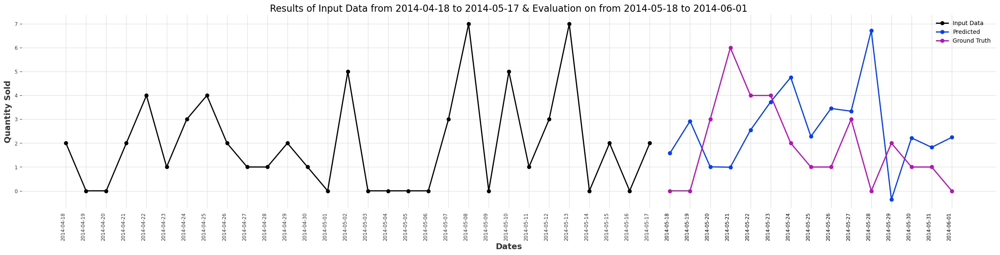

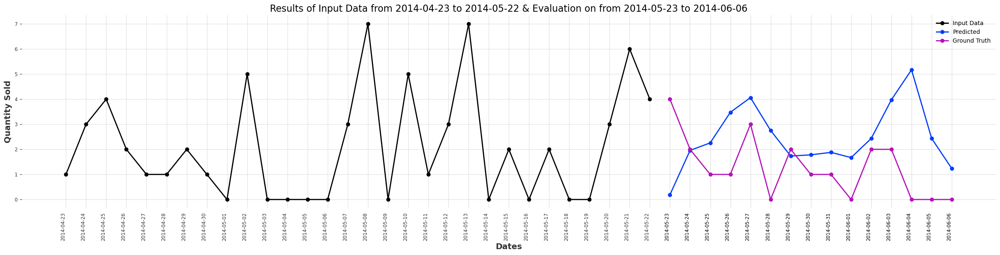

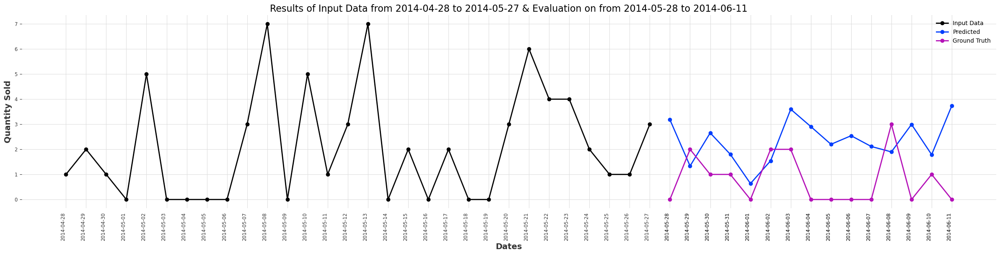

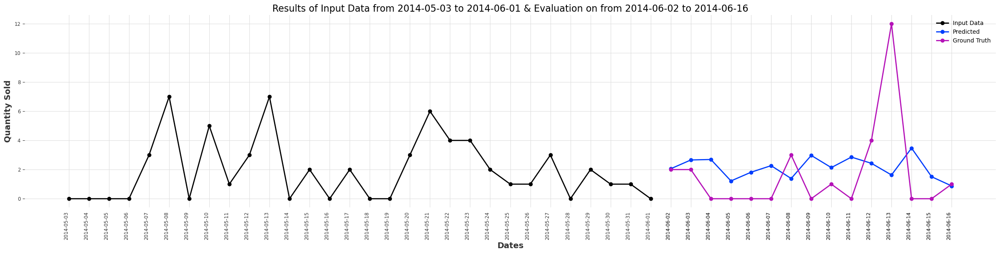

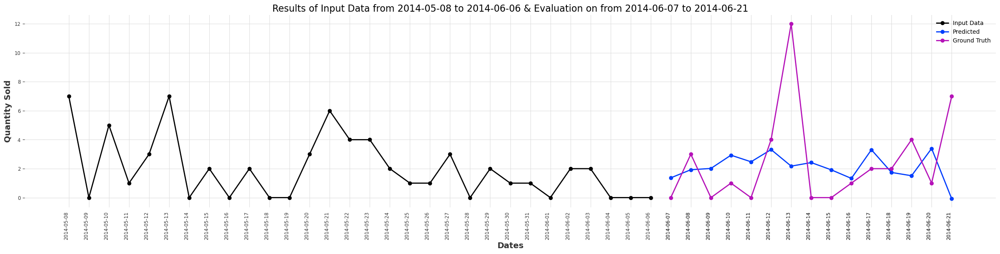

...

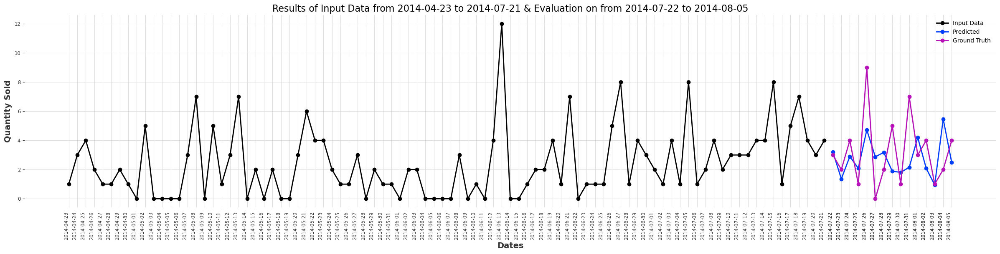

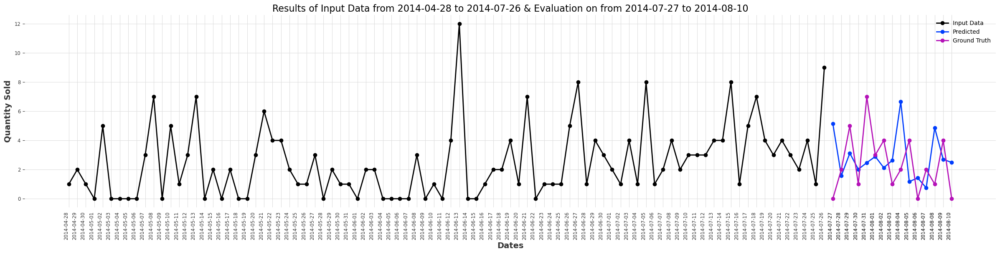

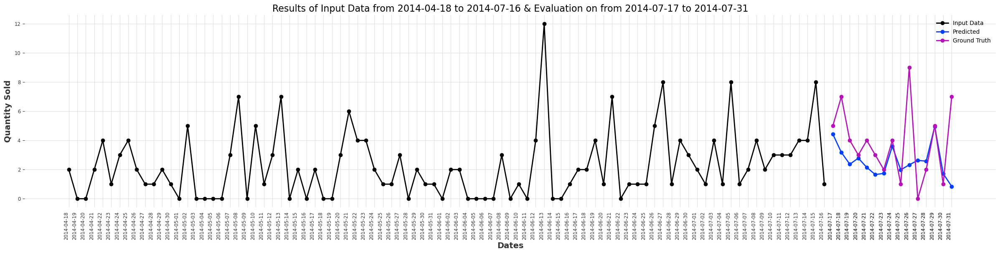

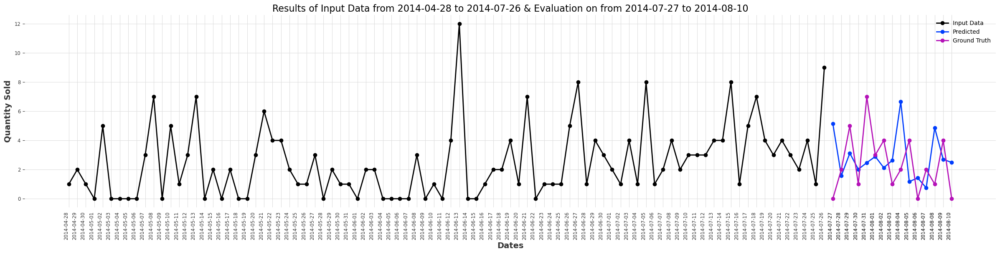

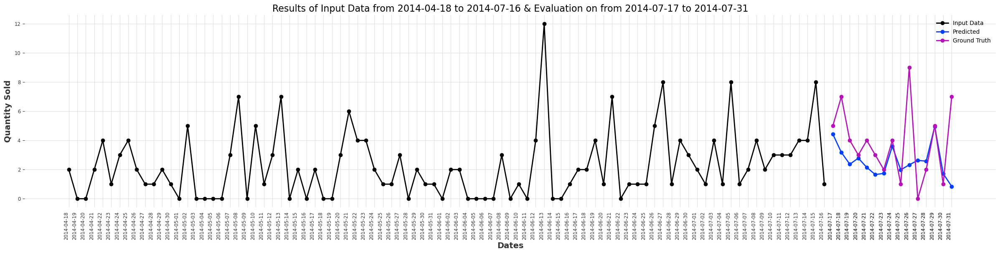

In [74]:
model_name = 'XGBMODEl'
model_object = xgb_model
test_series = test_series 
model_evaluation(model_name,model_object,test_series)